In [4]:
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import glob
import sys
sys.path.append("../lib/")
import eyegaze as eg

In [21]:
input_dir = "../../data/input/gaze/"
working_dir = "../../data/working/"
output_dir = "../../data/output/"
savepath = "../../data/working/feature/"

participant = "P13"

def v(df, column):      
    return df[column].values

def export_scanpath(participant):
    #num_paragraph = pd.read_csv(input_dir+"paragraphs.csv")["Paragraphs"].values

    for document, g in enumerate(sorted(glob.glob(input_dir+"/%s/*/" %participant))):
        #print (document, g)
        data = pd.read_csv(g + "smi_gaze.csv")
        capture = pd.read_csv(g + "capture.csv")["#timestamp"].values
        
        
            
        try:
            
            #gaze = data[(data["#timestamp"] > capture[i-2]) & (data["#timestamp"] < capture[i-1])]
            gaze = data[(data["#timestamp"] > capture[2]) & (data["#timestamp"] < capture[3])]
            #gaze = gaze[["#timestamp", "tobii_system_timestamp", "gaze_x", "gaze_y", "pupil_diameter", "left_gaze_x", "left_gaze_y", "left_pupil", "right_gaze_x", "right_gaze_y", "right_pupil"]]
            #gaze.to_csv(working_dir+"gaze/%s" %participant + "_D"+str(document).zfill(2) +"_p"+str(paragraph+1) +".csv", index=False)
            fx = eg.detectFixations(v(gaze, "#timestamp"), v(gaze, "right_gaze_x"), v(gaze, "right_gaze_y"))
            #fx.to_csv(working_dir+"feature/P01"+"_d"+str(document).zfill(2)+"_p"+str(paragraph+1)+".csv", index=False)

            eg.plotScanPath(fx[:, 1], fx[:, 2], fx[:, 3],
                    bg_image = g+str(4).zfill(3)+"_back.png")
        except:
            print("Error")

/Users/jai/Documents/IEEE-Interest/interest/analysis/code/ipynb/../lib/eyegaze.py:83: RuntimeWarning: divide by zero encountered in divide
  saccades = np.vstack((lengths, angles, np.array(lengths)/np.array(durations))).T


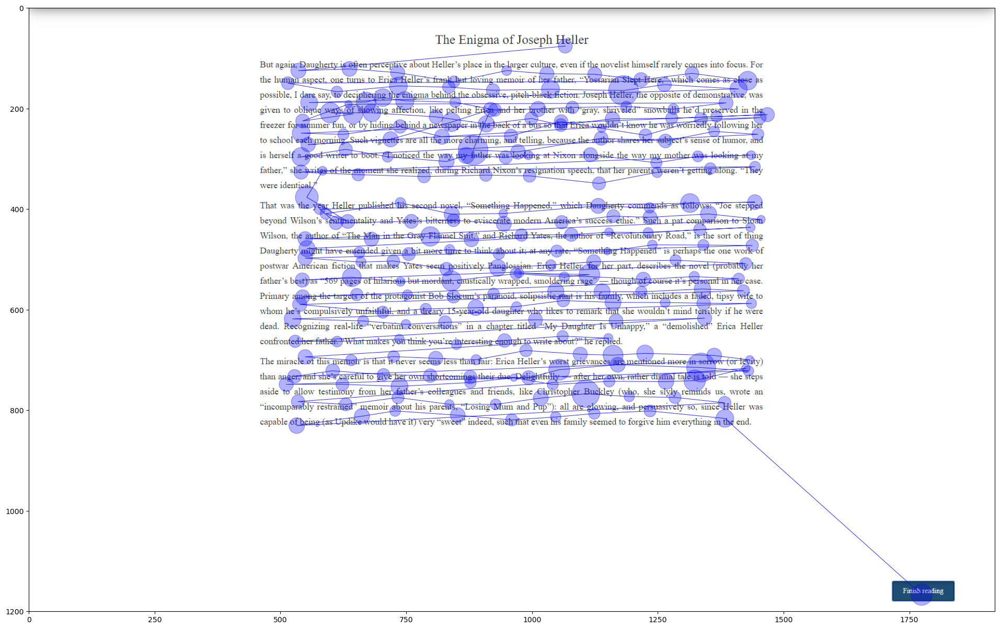

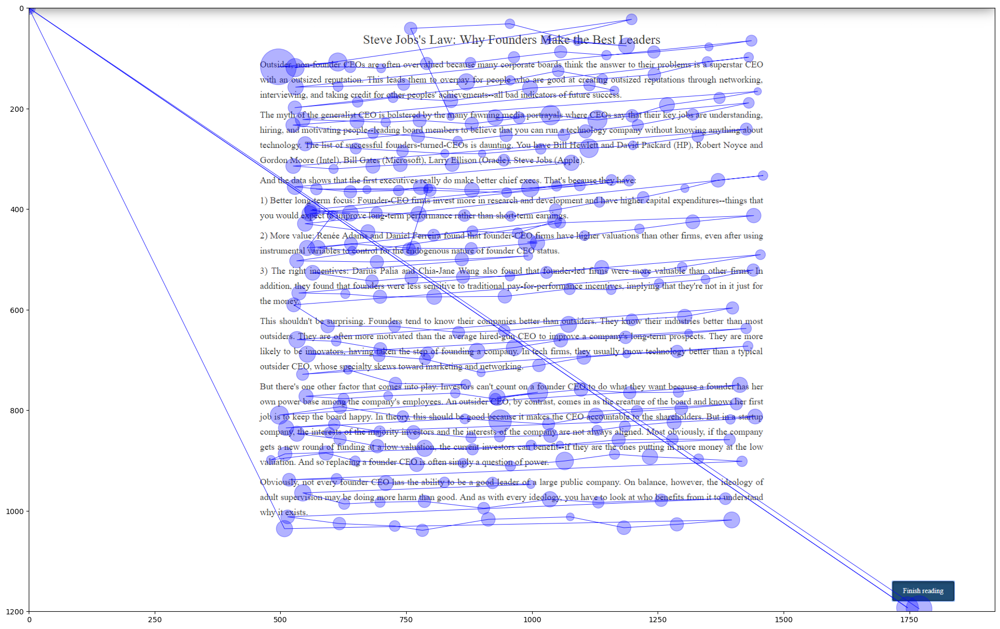

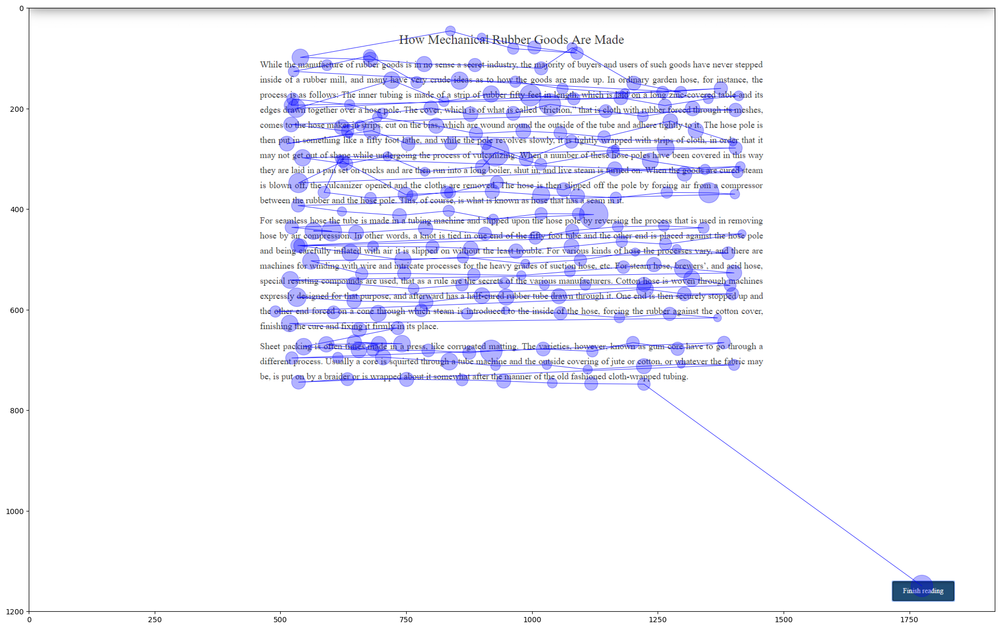

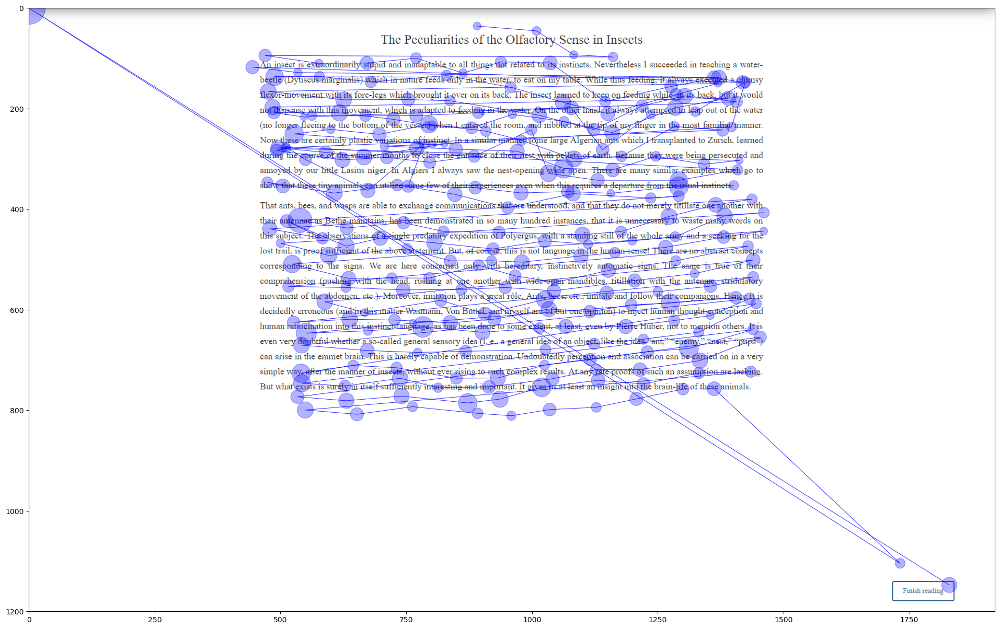

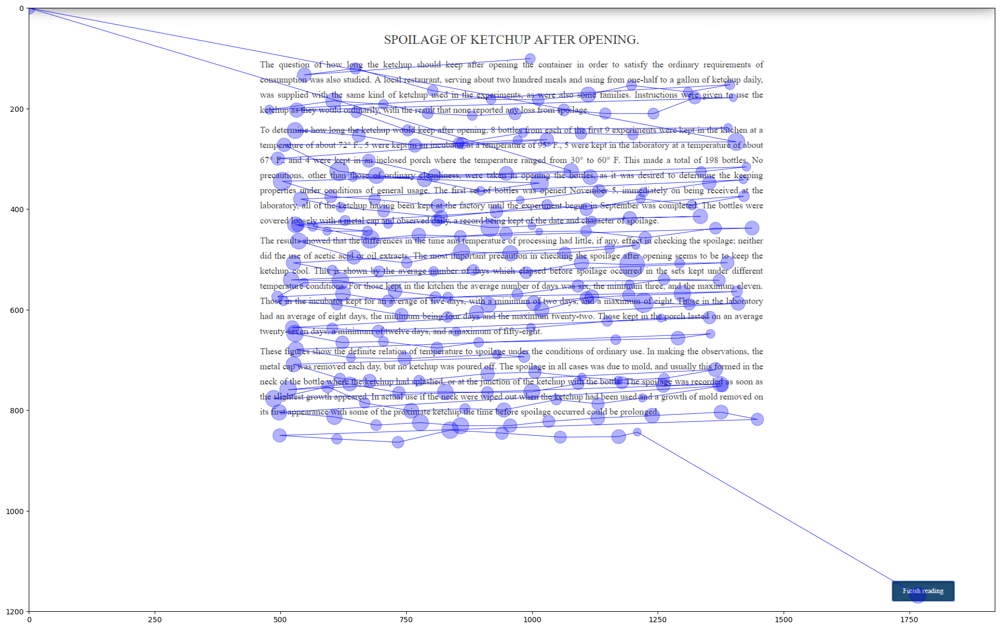

...

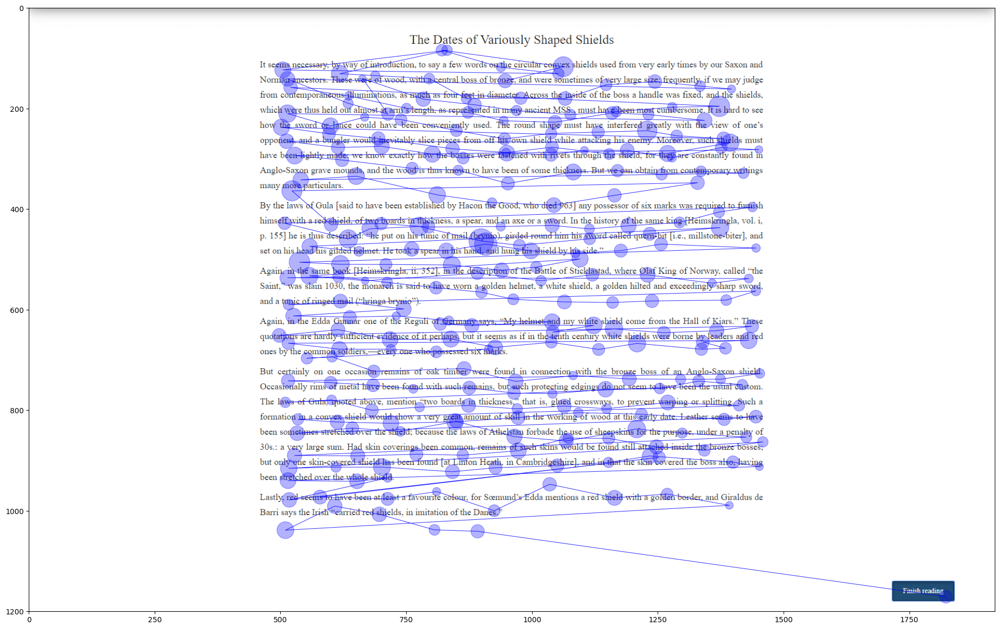

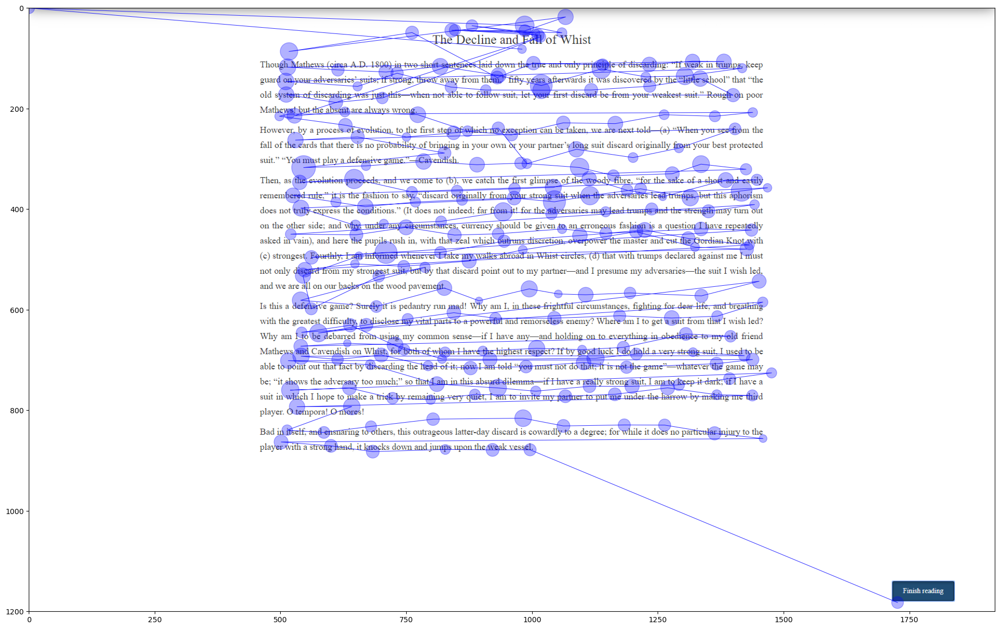

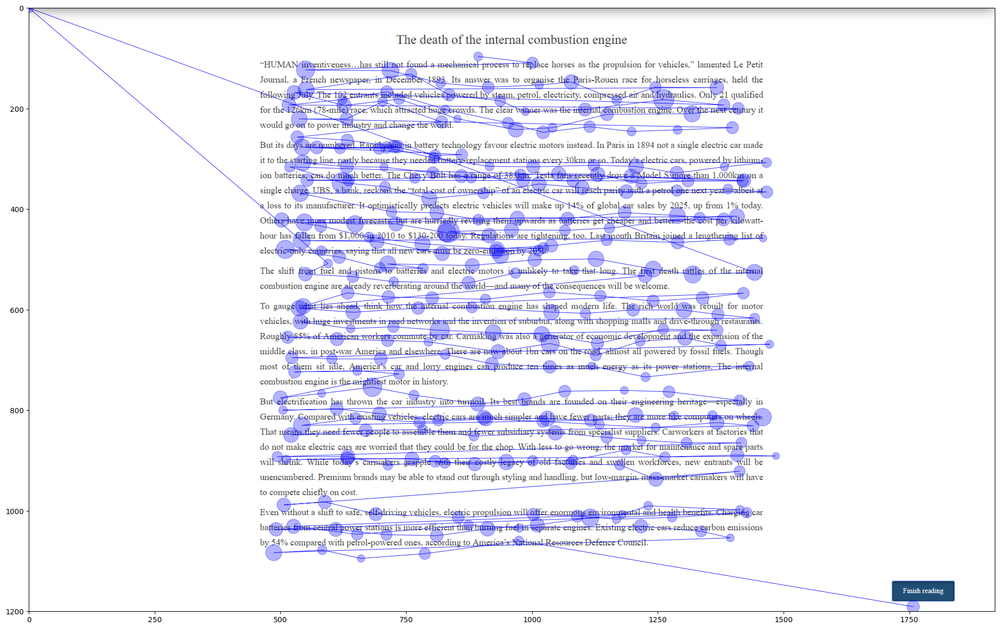

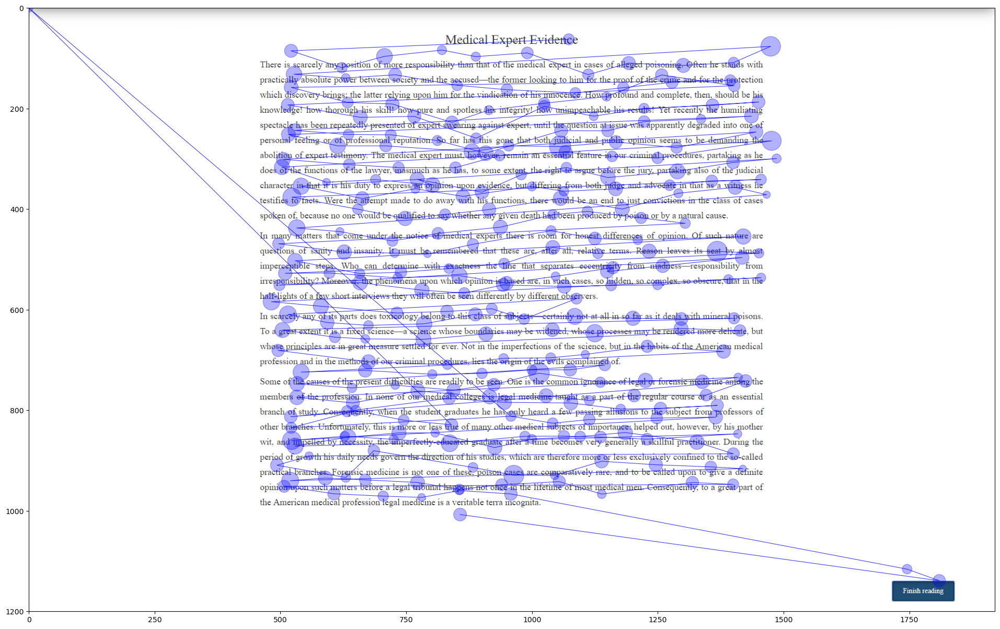

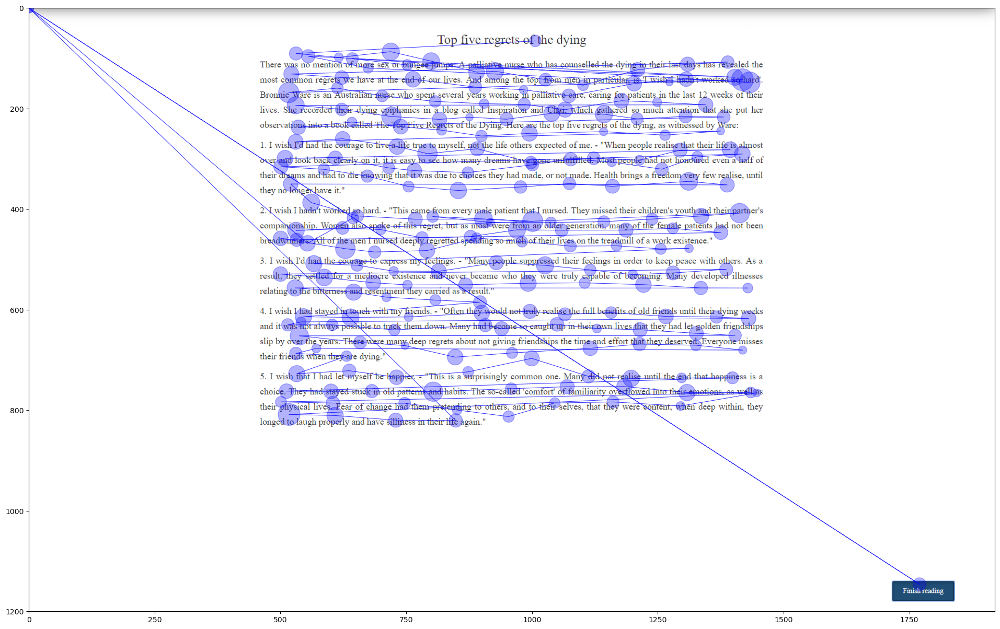

In [22]:
export_scanpath(participant)